# The AML Atlas Study (PaCMAP)

```{contents}
```

## Load data

In [1]:
import pandas as pd
import sys
sys.path.insert(0, '..')
from source.pacmap_functions import *

input_path = '../../Data/Intermediate_Files/'
output_path = '../../Data/Processed_Data/'

# read df_discovery and df_validation
df_discovery = pd.read_pickle(
    input_path+'3544samples-310940cpgs-withbatchcorrection-bvalues.pkl').sort_index()

df_validation = pd.read_pickle(
    input_path+'201samples-357839cpgs-withbatchcorrection-bvalues.pkl').sort_index()

# Load clinical data
discovery_clinical_data = pd.read_csv(input_path+'discovery_clinical_data_looserfiltering.csv',
                                      low_memory=False, index_col=0)

# Load clinical data
validation_clinical_data = pd.read_csv(input_path+'validation_clinical_data.csv',
                                        low_memory=False, index_col=0)

# Adjust clinical data
discovery_clinical_data['Train Test'] = 'Discovery (train) Samples'
validation_clinical_data['Train Test'] = 'Validation (test) Samples'

discovery_clinical_data['PaCMAP Output'] = 'Patient Samples'
validation_clinical_data['PaCMAP Output'] = 'Patient Samples'

discovery_clinical_data['Batch'] = df_discovery['Batch']
validation_clinical_data['Batch'] = 'St Jude Children\'s'


## Select CpGs in both train and test

In [2]:
# use overlapping features between df_discovery and df_validation
common_features = [x for x in df_discovery.columns if x in df_validation.columns]

# apply `common_features` to both df_discovery and df_validation
df_discovery = df_discovery[common_features]
df_validation = df_validation[common_features]

print(
f' Discovery dataset (df_discovery) contains {df_discovery.shape[1]} \
columns (5mC nucleotides/probes) and {df_discovery.shape[0]} rows (samples).')

print(
f' Validation dataset (df_validation) contains {df_validation.shape[1]} \
columns (5mC nucleotides/probes) and {df_validation.shape[0]} rows (samples).')

output_notebook()

# Set the theme for the plot
curdoc().theme = 'light_minimal' # or 'dark_minimal'

 Discovery dataset (df_discovery) contains 302884 columns (5mC nucleotides/probes) and 3544 rows (samples).
 Validation dataset (df_validation) contains 302884 columns (5mC nucleotides/probes) and 201 rows (samples).


Loading BokehJS ...

## Generate PaCMAP embeddings

In [3]:
clinical_trials = ['NOPHO ALL92-2000', 
                    'AAML0531',
                    'AAML1031',
                    'Beat AML Consortium',
                    'TCGA AML',
                    'CETLAM SMD-09 (MDS-tAML)',
                    'French GRAALL 2003–2005',
                    'TARGET ALL',
                    'AAML03P1',
                    'Japanese AML05',
                    'CCG2961']

sample_types = ['Diagnosis', 'Primary Blood Derived Cancer - Bone Marrow',
                'Bone Marrow Normal','Primary Blood Derived Cancer - Peripheral Blood',
                'Blood Derived Normal','Likely Diagnosis', 'Control (Healthy Donor)',
                'Relapse','Recurrent Blood Derived Cancer - Bone Marrow',
                'Recurrent Blood Derived Cancer - Peripheral Blood',
                'Peripheral Blood Normal']

cols = ['Clinical Trial', 'Sample Type', 'Patient_ID', 'ELN AML 2022 Diagnosis', 'Train Test', 'Batch', 'Hematopoietic Group']

components = [2,5]
for n in components:
    processor = DataProcessor(discovery_clinical_data.copy(),
                              df_discovery,
                              clinical_trials,
                              sample_types,
                              cols, 
                              n_components=n,
                              common_prefix=output_path+f'pacmap_output/pacmap_{n}d_model_acute_leukemia', 
                              df_test=df_validation.copy(),
                              test_clinical_data=validation_clinical_data.copy())
    
    processor.filter_data()
    processor.apply_pacmap() # learn PaCMAP on the training data
    processor.apply_pacmap_test() # apply PaCMAP to the test data
    processor.join_labels()

    # Save output
    processor.df.to_csv(output_path+f'pacmap_output/pacmap_{n}d_output_acute_leukemia.csv')


df = pd.read_csv(output_path+'pacmap_output/pacmap_2d_output_acute_leukemia.csv', index_col=0)

The PaCMAP instance is successfully saved at ../../Data/Processed_Data/pacmap_output/pacmap_2d_model_acute_leukemia.pkl.
To load the instance again, please do `pacmap.load(../../Data/Processed_Data/pacmap_output/pacmap_2d_model_acute_leukemia)`.
The PaCMAP instance is successfully saved at ../../Data/Processed_Data/pacmap_output/pacmap_5d_model_acute_leukemia.pkl.
To load the instance again, please do `pacmap.load(../../Data/Processed_Data/pacmap_output/pacmap_5d_model_acute_leukemia)`.


In [4]:
# Concatenate discovery and validation clinical data
clinical_data = pd.concat([discovery_clinical_data, validation_clinical_data]).loc[df['index']]

# Select columns to plot
cols = ['PaCMAP Output','Hematopoietic Group','WHO 2022 Diagnosis','WHO AML 2022 Diagnosis',
        'WHO ALL 2022 Diagnosis','ELN AML 2022 Diagnosis','Age (group years)', 'Batch', 'Sex',
        'Clinical Trial', 'Sample Type', 'Train Test']

# Join clinical data to the embedding
df = df.join(clinical_data[cols], rsuffix='_copy', on='index')

# Call the BokehPlotter class to plot the data
plotter = BokehPlotter(df, cols, get_custom_color_palette(), 
                       title='The Methylome Atlas of Acute Leukemia',
                       x_range=(-40, 40), y_range=(-50, 50),
                       datapoint_size=3, width=1300, height=800)
plotter.plot()

## The Methylome Atlas of Pediatric AML

In [5]:
clinical_trials = ['AAML0531', 'AAML1031', 'AAML03P1', 'CCG2961', 'Japanese AML05']

sample_types = ['Diagnosis', 'Primary Blood Derived Cancer - Bone Marrow', 'Bone Marrow Normal',
                'Primary Blood Derived Cancer - Peripheral Blood', 'Blood Derived Normal']

cols = ['Clinical Trial', 'Sample Type', 'Patient_ID', 'ELN AML 2022 Diagnosis', 'Train Test', 'Batch']

components = [2,5]
for n in components:
    processor = DataProcessor(discovery_clinical_data.copy(),
                              df_discovery,
                              clinical_trials,
                              sample_types,
                              cols, 
                              n_components=n,
                              common_prefix=output_path+f'pacmap_output/pacmap_{n}d_model_peds_dx_aml', 
                              df_test=df_validation.copy(),
                              test_clinical_data=validation_clinical_data.copy())
    
    processor.filter_data()
    processor.apply_pacmap() # learn PaCMAP on the training data
    processor.apply_pacmap_test() # apply PaCMAP to the test data
    processor.join_labels() # join clinical data to the embedding

    # Save output
    processor.df.to_csv(output_path+f'pacmap_output/pacmap_{n}d_model_peds_dx_aml.csv')

The PaCMAP instance is successfully saved at ../../Data/Processed_Data/pacmap_output/pacmap_2d_model_peds_dx_aml.pkl.
To load the instance again, please do `pacmap.load(../../Data/Processed_Data/pacmap_output/pacmap_2d_model_peds_dx_aml)`.
The PaCMAP instance is successfully saved at ../../Data/Processed_Data/pacmap_output/pacmap_5d_model_peds_dx_aml.pkl.
To load the instance again, please do `pacmap.load(../../Data/Processed_Data/pacmap_output/pacmap_5d_model_peds_dx_aml)`.


In [6]:
df2 = pd.read_csv(output_path+'pacmap_output/pacmap_2d_model_peds_dx_aml.csv', index_col=0)

# Select columns to plot
cols = ['PaCMAP Output','Hematopoietic Group','WHO AML 2022 Diagnosis','ELN AML 2022 Diagnosis', 'FAB', 'FLT3 ITD', 'Age (group years)',
        'Complex Karyotype', 'Primary Cytogenetic Code' ,'Batch', 'Sex', 'MRD 1 Status',
        'Leucocyte counts (10⁹/L)', 'Risk Group', 'Race or ethnic group',
        'Clinical Trial', 'Vital Status','First Event','Sample Type', 'Train Test']

# Join clinical data to the embedding
df2 = df2.join(clinical_data[cols], rsuffix='_copy', on='index')

plotter = BokehPlotter(df2, cols, get_custom_color_palette(),
                       title='The Methylome Atlas of Pediatric AML',
                        x_range=(-45, 45), y_range=(-45, 45),
                        datapoint_size=3, tooltip_dx_cols='ELN AML 2022 Diagnosis',
                        width=1000, height=500)
plotter.plot()

## Patient Characteristics Table

In [7]:
from tableone import TableOne

columns = ['Hematopoietic Group','Age (group years)','Sex',
            'Clinical Trial',]

df_train = df[df['Train Test']=='Discovery (train) Samples']

mytable_cog = TableOne(df_train.reset_index(), columns,
                        overall=False, missing=False,
                        pval=False, pval_adjust=False,
                        htest_name=True,dip_test=True,
                        tukey_test=True, normal_test=True,

                        order={'FLT3 ITD':['Yes','No'],
                                'Age (group years)':['0-5','5-13','13-39','39-60'],
                                'MRD 1 Status': ['Positive'],
                                'Risk Group': ['High Risk', 'Standard Risk'],
                                'FLT3 ITD': ['Yes'],
                                'Leucocyte counts (10⁹/L)': ['≥30'],
                                'Age group (years)': ['≥10']})

# mytable_cog.to_excel('data/tableone_Dx_pacmap.xlsx')
# mytable_cog.to_csv(output_path + 'pacmap_output/tableone_Dx_pacmap.csv')

mytable_cog.tabulate(tablefmt="html", 
                        # headers=[score_name,"",'Missing','Discovery','Validation','p-value','Statistical Test']
                        )

,,Overall
n,,3273
"Hematopoietic Group, n (%)",Acute lymphoblastic leukemia (ALL),906 (35.5)
,Acute myeloid leukemia (AML),1274 (49.9)
,Acute promyelocytic leukemia (APL),31 (1.2)
,Mixed phenotype acute leukemia (MPAL),51 (2.0)
,Myelodysplastic syndrome (MDS or MDS-like),153 (6.0)
,Otherwise-Normal (Control),140 (5.5)
"Age (group years), n (%)",0-5,540 (24.5)
,5-13,552 (25.1)
,13-39,742 (33.7)


## Pie charts

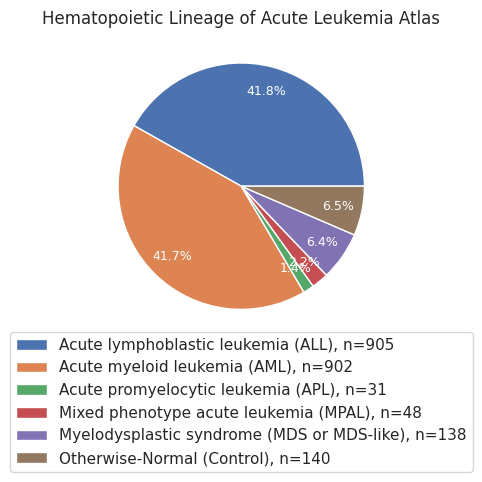

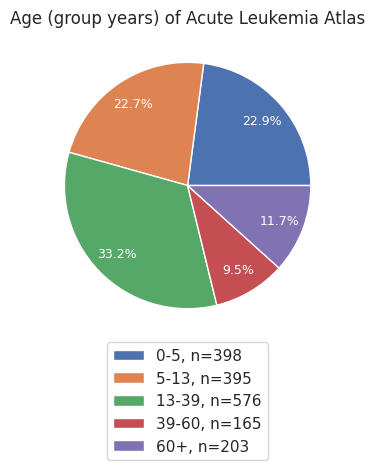

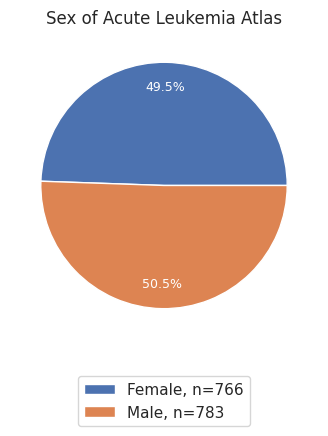

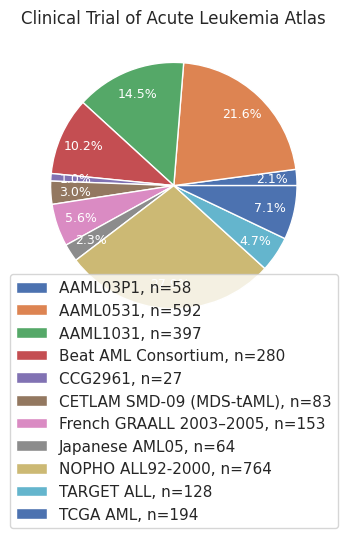

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

sns.set_theme(style="whitegrid")

# Set font size for all plots
plt.rcParams.update({'font.size': 9})

table = pd.read_csv(output_path + 'pacmap_output/tableone_Dx_pacmap.csv').iloc[1:,:]
# Extract counts and percentages from 'Overall' column
table[['Count','Percent']] = table['Overall'].str.split(' ', expand=True)
table['Count'] = table['Count'].str.replace('(','').str.replace(')','')
table['Percent'] = table['Percent'].str.replace('(','').str.replace(')','').str.replace('%','')

# Convert columns to appropriate data types
table['Count'] = pd.to_numeric(table['Count'], errors='coerce')
table['Percent'] = pd.to_numeric(table['Percent'], errors='coerce')

table = table.dropna(subset=['Count', 'Percent'])

# Group by 'Unnamed: 0' column (Categories) and create a pie chart for each
categories = table['Unnamed: 0'].unique()

for category in categories:
    temp_table = table[table['Unnamed: 0'] == category]
    fig, ax = plt.subplots(figsize=(7,4))
    patches, texts, autotexts = ax.pie(temp_table['Count'], autopct='%1.1f%%',
                                        pctdistance=0.8, wedgeprops=dict(edgecolor='w'),
                                        )
    ax.set_title(category.replace(', n (%)', '') + ' of Acute Leukemia Atlas')
    labels = [f"{label}, n={count}" for label, count in zip(temp_table['Unnamed: 1'], temp_table['Count'])]
    ax.legend(patches, labels, loc="center", bbox_to_anchor=(0.5, -0.2))

    # Adjust font size and weight
    for autotext in autotexts:
        autotext.set_color('white')

    plt.show()



## Watermark

In [9]:
%load_ext watermark

In [10]:
# watermark with all libraries used in this notebook
%watermark -v -p numpy,pandas,bokeh,pacmap,itables -a Francisco_Marchi@Lamba_Lab_UF -d -m

Author: Francisco_Marchi@Lamba_Lab_UF

Python implementation: CPython
Python version       : 3.8.16
IPython version      : 8.12.2

numpy  : 1.24.3
pandas : 2.0.2
bokeh  : 3.1.1
pacmap : 0.7.0
itables: 1.5.2

Compiler    : GCC 11.3.0
OS          : Linux
Release     : 5.15.133.1-microsoft-standard-WSL2
Machine     : x86_64
Processor   : x86_64
CPU cores   : 20
Architecture: 64bit

